# Analysis of sequential DNA-MERFISH for SI14

by Pu Zheng

2022.06.25

analysis for dataset:

\\10.245.74.158\Chromatin_NAS_7\20220616-hSTG0308_SI14_from_0601


In [1]:
%run "..\..\Startup_py3.py"
sys.path.append(r"..\..\..\..\Documents")

import ImageAnalysis3 as ia
%matplotlib notebook

from ImageAnalysis3 import *
print(os.getpid())

import h5py
from ImageAnalysis3.classes import _allowed_kwds
import ast

34996


## 0.1 Folders

In [5]:
save_folder = r'\\mendel\Mendel_SSD1\Pu_Temp\20220616-hSTG0308_SI14_from_0601'
save_filenames = [os.path.join(save_folder, _fl) for _fl in os.listdir(save_folder)
                  if _fl.split(os.extsep)[-1]=='hdf5']
# extract fov_id
save_fov_ids = [int(os.path.basename(_fl).split('.hdf5')[0].split('_')[-1]) for _fl in save_filenames]

debug = False

print(f"{len(save_filenames)} fovs detected")

segmentation_folder = os.path.join(save_folder, 'Segmentation')
if not os.path.exists(segmentation_folder):
    os.makedirs(segmentation_folder)
    print(f"Creating segmentation_folder: {segmentation_folder}")
else:
    print(f"Use segmentation_folder: {segmentation_folder}")

cand_spot_folder = os.path.join(save_folder, 'CandSpots')
if not os.path.exists(cand_spot_folder):
    os.makedirs(cand_spot_folder)
    print(f"Creating cand_spot_folder: {cand_spot_folder}")
else:
    print(f"Use cand_spot_folder: {cand_spot_folder}")

decoder_folder = cand_spot_folder.replace('CandSpots', 'Decoder')
if debug:
    _version = 0
    while os.path.exists(os.path.join(decoder_folder, f'v{_version}')):
        _version += 1
    decoder_folder = os.path.join(decoder_folder, f'v{_version}')
if not os.path.exists(decoder_folder):
    os.makedirs(decoder_folder)
    print(f"Creating decoder_folder: {decoder_folder}")
else:
    print(f"Use decoder_folder: {decoder_folder}")

picked_folder = os.path.join(save_folder, 'Picked_v0')
if not os.path.exists(picked_folder):
    os.makedirs(picked_folder)
    print(f"Creating picked_folder: {picked_folder}")
else:
    print(f"Use picked_folder: {picked_folder}")

204 fovs detected
Use segmentation_folder: \\mendel\Mendel_SSD1\Pu_Temp\20220616-hSTG0308_SI14_from_0601\Segmentation
Use cand_spot_folder: \\mendel\Mendel_SSD1\Pu_Temp\20220616-hSTG0308_SI14_from_0601\CandSpots
Use decoder_folder: \\mendel\Mendel_SSD1\Pu_Temp\20220616-hSTG0308_SI14_from_0601\Decoder
Use picked_folder: \\mendel\Mendel_SSD1\Pu_Temp\20220616-hSTG0308_SI14_from_0601\Picked_v0


## 0.2 Figure info

In [6]:
save_figure = True
#figure_folder = os.path.join(save_folder, 'Figures_final')
figure_folder = os.path.join(save_folder, 'Figures_0625')
if not os.path.exists(figure_folder):
    print(f"Create figure_folder: {figure_folder}")
    os.makedirs(figure_folder)
else:
    print(f"Use figure_folder: {figure_folder}")

Use figure_folder: \\mendel\Mendel_SSD1\Pu_Temp\20220616-hSTG0308_SI14_from_0601\Figures_0625


## 0.3 other parameters

save_filenames = save_filenames[:153]
save_fov_ids = save_fov_ids[:153]

# 1. Load all [chr_2_hzxys_list] into cell types

## 1.1 Get dict for cell uid

In [7]:
%%time
fovcell_2_uid = {}

for _fov_id, _save_filename in zip(save_fov_ids, save_filenames):
    # segmentation filename
    _segmentation_savefile = os.path.join(segmentation_folder, 
        os.path.basename(_save_filename).replace('.hdf5', '_Segmentation.hdf5') )
    
    with h5py.File(_segmentation_savefile, 'r') as _f:
        for _fov_id in _f.keys():
            _fov_group = _f[_fov_id]
            _uid_group = _fov_group['cell_2_uid']
            for _cell_id in _uid_group.keys():
                fovcell_2_uid[(_fov_id, _cell_id)] = _uid_group[_cell_id][:][0].decode()
    print(len(fovcell_2_uid))

54
119
178
242
328
395
468
525
585
643
692
761
826
911
946
1013
1076
1149
1231
1303
1410
1480
1541
1604
1670
1743
1807
1875
1930
1978
2050
2106
2161
2256
2306
2376
2455
2515
2569
2638
2681
2740
2791
2859
2922
2984
3048
3116
3172
3289
3405
3498
3597
3664
3736
3796
3855
3912
4001
4072
4128
4185
4233
4304
4390
4497
4586
4655
4714
4855
4926
5005
5052
5146
5199
5242
5312
5372
5433
5504
5566
5630
5702
5750
5810
5890
5959
6016
6066
6126
6182
6260
6328
6401
6462
6529
6584
6634
6695
6746
6814
6889
6961
7040
7100
7161
7246
7343
7409
7487
7562
7645
7720
7796
7863
7944
7998
8057
8128
8202
8292
8380
8432
8489
8558
8623
8678
8728
8783
8839
8889
8940
8989
9038
9085
9146
9220
9318
9440
9484
9530
9573
9612
9661
9707
9757
9805
9866
9941
9994
10044
10113
10167
10231
10283
10330
10394
10454
10498
10562
10622
10670
10750
10829
10901
10971
11052
11125
11203
11273
11362
11401
11441
11493
11538
11591
11634
11677
11738
11774
11813
11853
11880
11912
11954
11985
12005
12031
12069
12107
12125
12180
12258
12309
12

## 1.2 cell type annotation

In [32]:
%%time
import scanpy as sc

# load cell type info
merfish_cluster_file = r'\\mendel\Mendel_SSD3\MERFISH_Analysis\20220601-hSTG\PostAnalysis\filtered_cluster_data.h5ad'

merfish_df = sc.read_h5ad(merfish_cluster_file)

uid_2_class = {_uid:_class for _uid, _class in zip(merfish_df.obs.index, merfish_df.obs['leiden_cluster'])}

Wall time: 89.1 ms


## 1.3 load codebook

In [9]:
# load two codebooks
import pandas as pd

si14_codebook = pd.read_csv(r'\\10.245.74.212\Chromatin_NAS_2\Chromatin_Libraries\DNA-MERFISH_Seon\SI14\SI14_codebook.csv', header=0)
si14_codebook

,name,id,chr,chr_order,Stv_3,Stv_5,Stv_7,Stv_10,Stv_12,Stv_14,...,Stv_66,Stv_68,Stv_93,Stv_96,Stv_98,Stv_112,Stv_115,Stv_117,Stv_128,Stv_137
0,1:2950000-3050000,0,1,0,0,0,1,0,1,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1:5950000-6050000,1,1,1,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,1:8950000-9050000,2,1,2,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,1:11950000-12050000,3,1,3,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,1:14950000-15050000,4,1,4,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1036,X:140950000-141050000,1036,X,46,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1037,X:143950000-144050000,1037,X,47,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1038,X:146950000-147050000,1038,X,48,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1039,X:149950000-150050000,1039,X,49,0,0,0,0,0,0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


## 2.1 load chr_2_zxys_list

In [10]:
import re
import multiprocessing as mp
from ImageAnalysis3.classes.decode import load_hdf5_dict
from ImageAnalysis3.classes.decode import DNA_Merfish_Decoder

#decoder_folder = os.path.join(save_folder, 'Decoder')
picked_filenames = [os.path.join(picked_folder, _fl) for _fl in os.listdir(picked_folder) 
                     if re.search(r'Picked_fov-(?P<fovId>[0-9]+)_cell-(?P<cellId>[0-9]+).hdf5', _fl) is not None
                    ]
print(picked_folder, len(picked_filenames))

\\mendel\Mendel_SSD1\Pu_Temp\20220616-hSTG0308_SI14_from_0601\Picked_v0 12559


In [11]:
%%time
print("Batch load chr_2_hzxys_list")
# Batch loading
load_args = [(_fl, 'picked/chr_2_filtered_hzxys_list') for _fl in picked_filenames]
print(len(load_args))
with mp.Pool(44) as load_pool:
    all_chr_2_hzxys_list = load_pool.starmap(load_hdf5_dict, 
                                            load_args, 
                                            chunksize=1)
    load_pool.close()
    load_pool.join()
    load_pool.terminate()

Batch load chr_2_hzxys_list
12559
Wall time: 35.3 s


In [12]:
uid_list = [fovcell_2_uid[
    re.findall(r'Picked_fov-(?P<fovId>[0-9]+)_cell-(?P<cellId>[0-9]+).hdf5', os.path.basename(_fl))[0]
           ] for _fl in picked_filenames]
len(uid_list)

12559

In [13]:
# convert into zxys
all_chr_2_zxys_list = []
for _chr_2_hzxys_list in all_chr_2_hzxys_list:
    all_chr_2_zxys_list.append( {_k:_v[:,:,1:] for _k,_v in _chr_2_hzxys_list.items()} )

## 2.2 split chr_2_hzxys into classes

In [33]:
class_2_chr_zxys = {}
for _class in np.unique(merfish_df.obs['leiden_cluster']):
    if _class not in class_2_chr_zxys:
        class_2_chr_zxys[_class] = []
    for _uid, _chr_zxys in zip(uid_list, all_chr_2_zxys_list):
        
        if _uid in uid_2_class and uid_2_class[_uid] == _class:
            class_2_chr_zxys[_class].append(_chr_zxys)
    print(_class, len(class_2_chr_zxys[_class]))      
class_2_chr_zxys = {_k:_v for _k,_v in class_2_chr_zxys.items() if len(_v)}
# save
save_class_2_chr_zxys = os.path.join(decoder_folder, f"class_2_chr_zxys_n{len(all_chr_2_zxys_list)}.pkl")
print("Save class_2_chr_zxys:", save_class_2_chr_zxys)
pickle.dump(class_2_chr_zxys, open(save_class_2_chr_zxys, 'wb'))

0 927
1 617
10 134
11 131
12 72
13 43
14 28
15 24
16 15
17 6
2 550
3 545
4 483
5 443
6 410
7 342
8 258
9 214
Save class_2_chr_zxys: \\mendel\Mendel_SSD1\Pu_Temp\20220616-hSTG0308_SI14_from_0601\Decoder\class_2_chr_zxys_n12559.pkl


## 2.3 summarize chr_zxys into classes

In [37]:
%%time
from ImageAnalysis3.structure_tools import distance
reload(distance)

min_class_num_cell = 100

class_2_summary_dict = {
    _class:distance.Chr2ZxysList_2_summaryDict(_chr_2_zxys_list, si14_codebook, num_threads=32, verbose=True) 
    for _class, _chr_2_zxys_list in class_2_chr_zxys.items() 
    if _class not in ['Other'] and len(_chr_2_zxys_list) > min_class_num_cell
}

-- preparing chr_2_zxys from 927 cells in 0.200s.
-- summarize 276 inter-chr distances with 44 threads in 40.135s.
-- preparing chr_2_zxys from 617 cells in 0.126s.
-- summarize 276 inter-chr distances with 44 threads in 36.048s.
-- preparing chr_2_zxys from 134 cells in 0.018s.
-- summarize 276 inter-chr distances with 44 threads in 29.588s.
-- preparing chr_2_zxys from 131 cells in 0.019s.
-- summarize 276 inter-chr distances with 44 threads in 31.327s.
-- preparing chr_2_zxys from 550 cells in 0.112s.
-- summarize 276 inter-chr distances with 44 threads in 33.967s.
-- preparing chr_2_zxys from 545 cells in 0.086s.
-- summarize 276 inter-chr distances with 44 threads in 36.035s.
-- preparing chr_2_zxys from 483 cells in 0.092s.
-- summarize 276 inter-chr distances with 44 threads in 36.674s.
-- preparing chr_2_zxys from 443 cells in 0.079s.
-- summarize 276 inter-chr distances with 44 threads in 32.284s.
-- preparing chr_2_zxys from 410 cells in 0.062s.
-- summarize 276 inter-chr dis

In [38]:
# save
save_class_2_median_dist = os.path.join(decoder_folder, f"class_2_median_dist_n{len(all_chr_2_zxys_list)}.pkl")
print("Save class_2_summary_dict:", save_class_2_median_dist)
pickle.dump(class_2_summary_dict, open(save_class_2_median_dist, 'wb'))

Save class_2_summary_dict: \\mendel\Mendel_SSD1\Pu_Temp\20220616-hSTG0308_SI14_from_0601\Decoder\class_2_median_dist_n12559.pkl


In [47]:
def _calculate_contact(cdist_list, axis=0, contact_th=600):
    

False

## 3.4 plot cell-type cis-trans

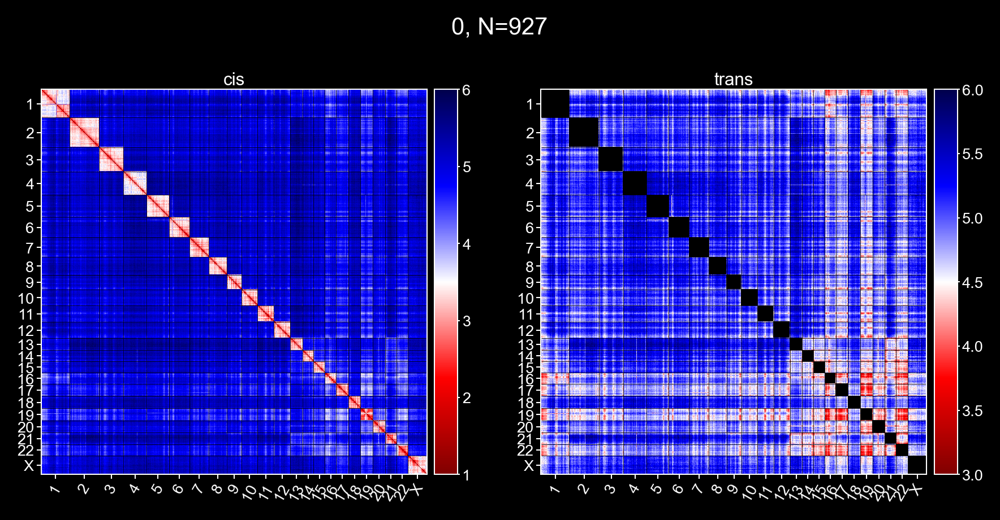

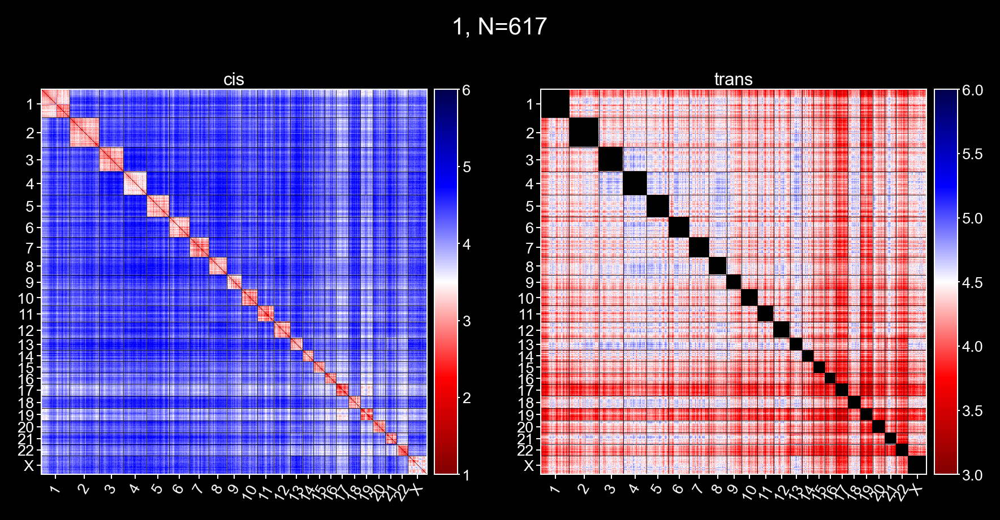

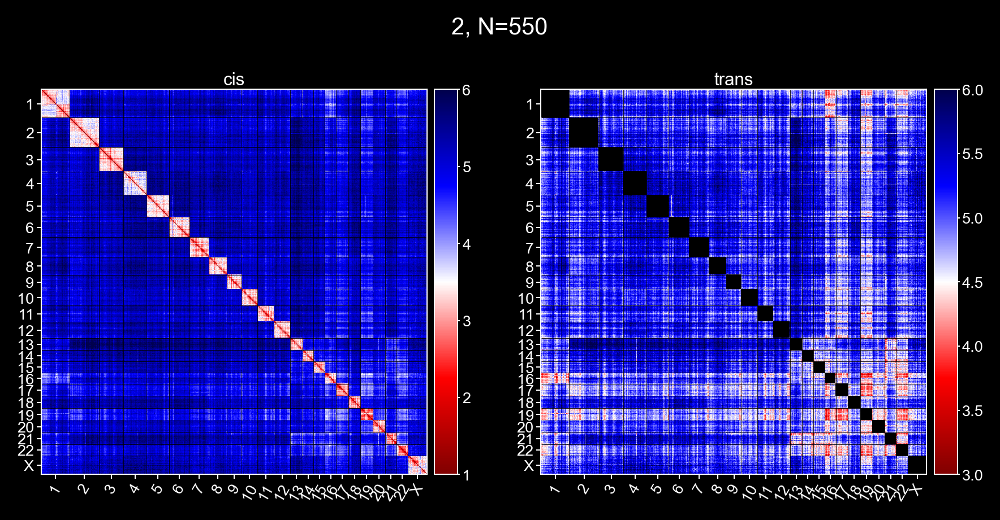

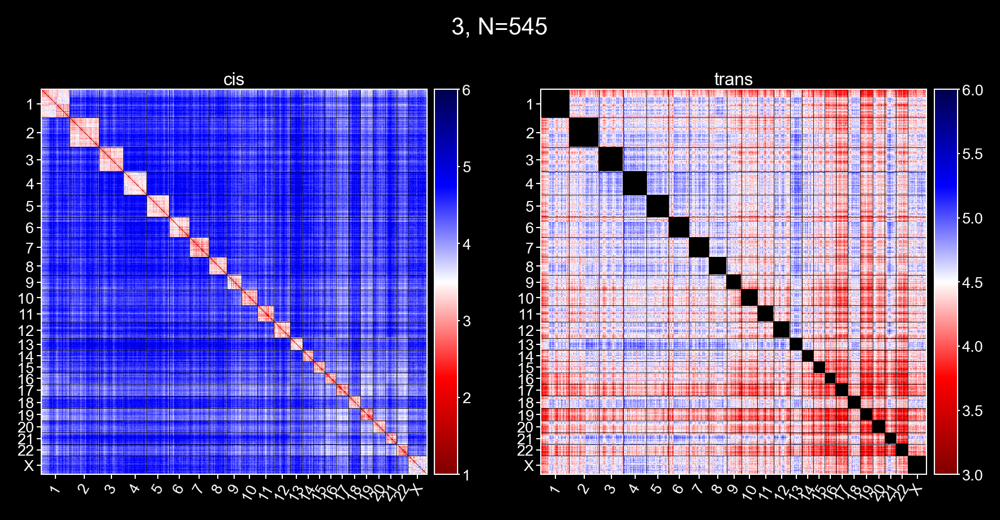

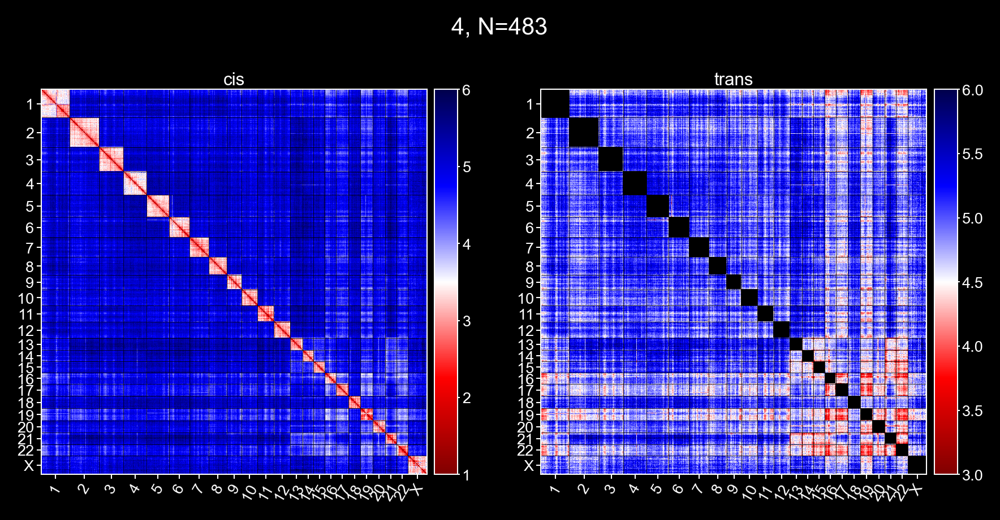

...

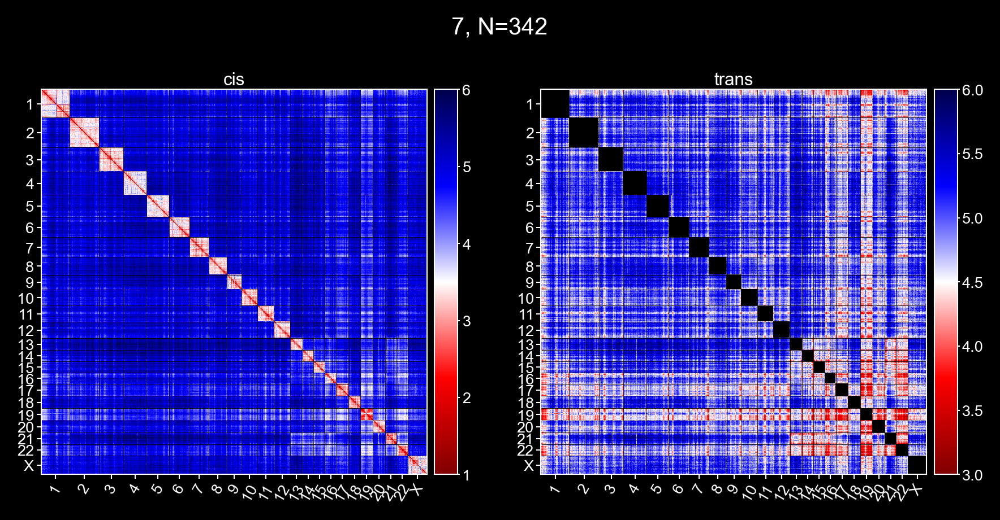

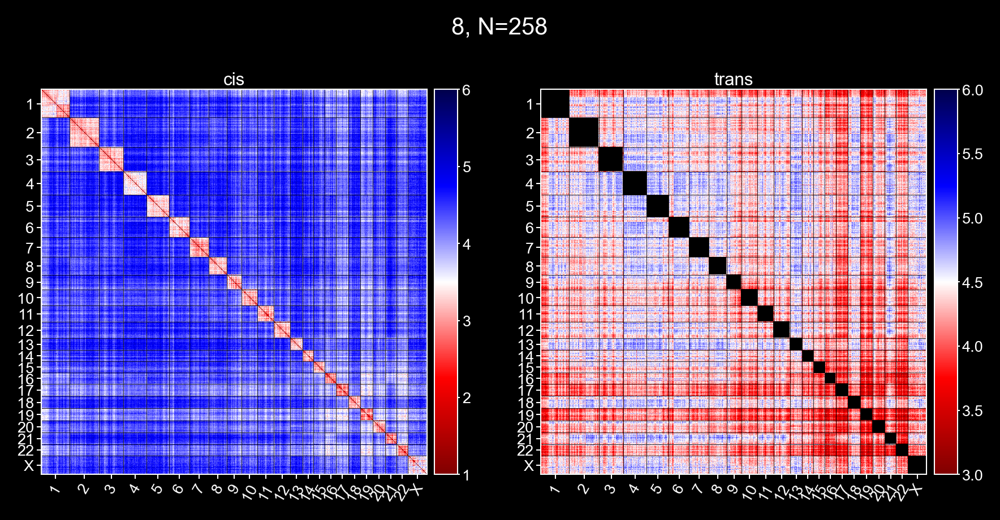

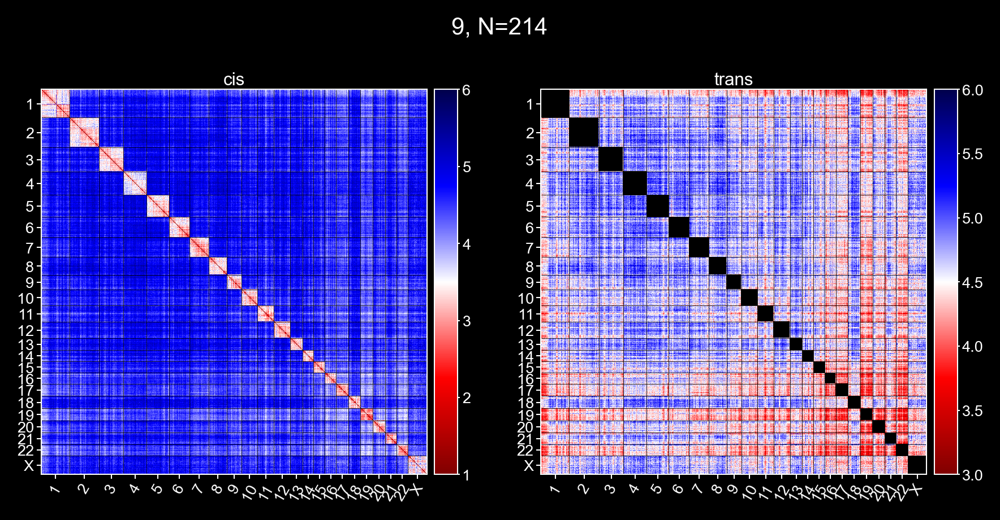

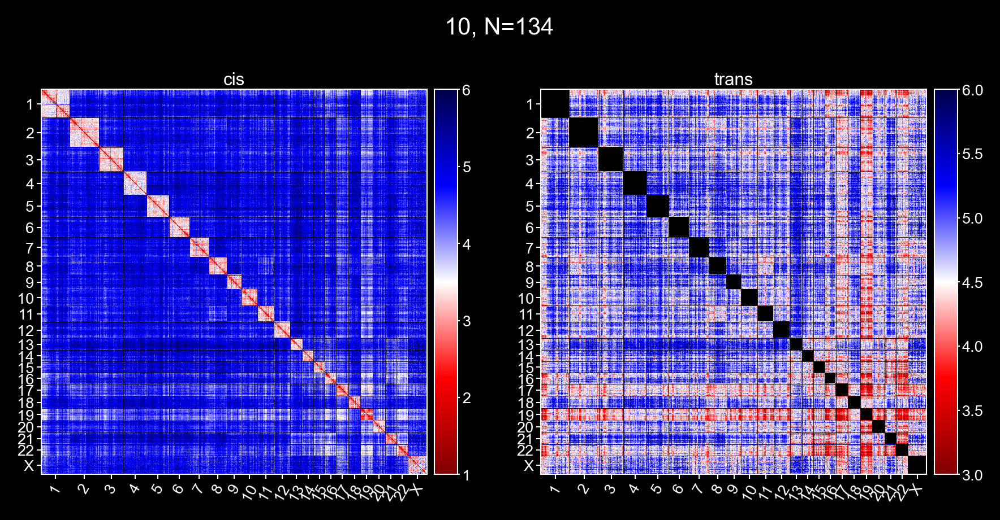

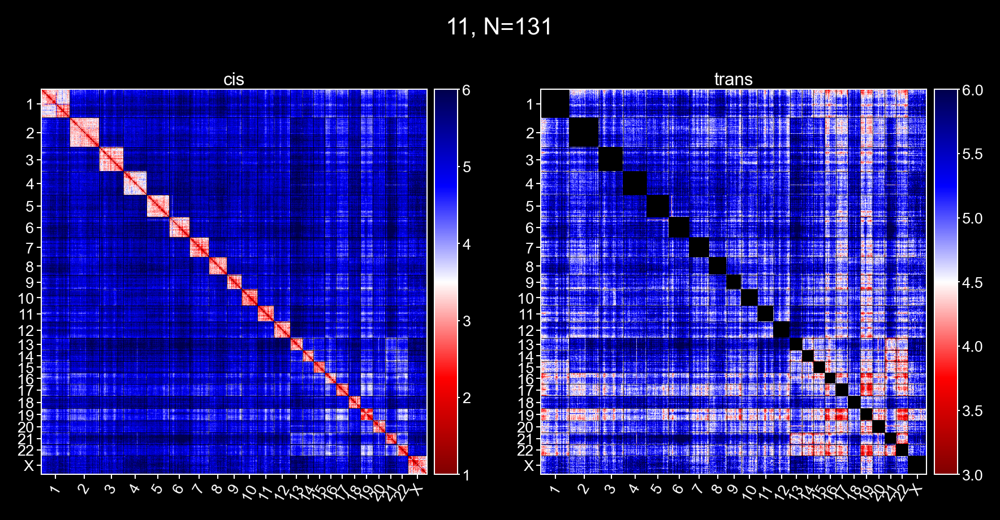

In [39]:
%matplotlib inline

plt.style.use('dark_background')
_single_im_size=3
sel_codebook = si14_codebook
sort_by_region = True

for _class, summary_dict in sorted(class_2_summary_dict.items(), key=lambda v:int(v[0])):
    
    _cis_mat, chr_edges, chr_names = distance.assemble_ChrDistDict_2_Matrix(
        summary_dict, si14_codebook, 
        sel_codebook=sel_codebook, 
        use_cis=True, sort_by_region=sort_by_region,
    )
    _trans_mat, chr_edges, chr_names = distance.assemble_ChrDistDict_2_Matrix(
        summary_dict, si14_codebook, 
        sel_codebook=sel_codebook, 
        use_cis=False, sort_by_region=sort_by_region,
    )

    fig, axes = plt.subplots(1, 2, figsize=(_single_im_size*2, _single_im_size*1.1), dpi=300, sharex=True, sharey=True)

    ia.figure_tools.distmap.plot_distance_map(_cis_mat/1000, color_limits=[1,6],
                                              ax=axes[0], 
                                                ticks=(chr_edges[1:] + chr_edges[:-1])/2,
                                              tick_labels=chr_names,
                                              font_size=6.5)
    ia.figure_tools.distmap.plot_distance_map(_trans_mat/1000, color_limits=[3,6],
                                              ax=axes[1], 
                                              ticks=(chr_edges[1:] + chr_edges[:-1])/2,
                                              tick_labels=chr_names, 
                                              font_size=6.5)

    axes[0].set_title(f'cis', fontsize=7.5, pad=2)
    axes[1].set_title(f'trans', fontsize=7.5, pad=2)
    for _ax in axes:
        _ax.hlines(chr_edges-0.5, 0, len(_cis_mat), color='black', linewidth=0.2)
        _ax.vlines(chr_edges-0.5, 0, len(_cis_mat), color='black', linewidth=0.2)
        _ax.xaxis.set_tick_params(which='both', labelbottom=True)
        _ax.yaxis.set_tick_params(which='both', labelleft=True)
    
    fig.subplots_adjust(wspace=0.2, hspace=0.2, left=0.05, right=0.95, top=0.97, bottom=0.02)
    fig.suptitle(f"{_class}, N={len(class_2_chr_zxys[_class])}", fontsize=10, y=0.97)
    fig.savefig(os.path.join(figure_folder, f"cis-trans-median_distmap_byreg_{_class.replace('/','_')}.png"))
    #fig.show()

## 3.5 plot cis for all types

In [40]:
visualize_chr = True

sort_by_region = False

chr_2_indices, chr_2_orders = distance.Generate_PlotOrder(si14_codebook, sel_codebook, sort_by_region=sort_by_region)


C:\Users\puzheng\AppData\Local\Temp/ipykernel_34996/2799399635.py:41: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "tranparent" which is no longer supported as of 3.3 and will become an error two minor releases later
  fig.savefig(os.path.join(figure_folder, f"all_type_cis_median_distmap_chr-{sel_chr}.png"),
C:\Users\puzheng\AppData\Local\Temp/ipykernel_34996/2799399635.py:46: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


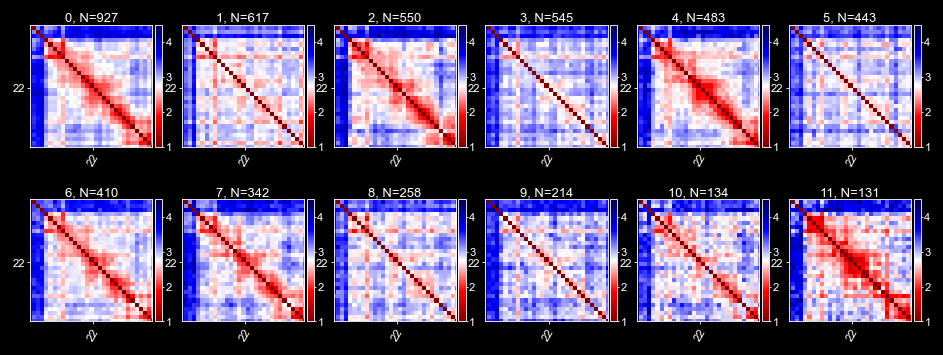

In [42]:
#%matplotlib inline
_single_im_size=1.25
_num_cols = 6
_num_rows =  int(np.ceil(len(class_2_summary_dict)/_num_cols))
fig, axes_list = plt.subplots(_num_rows, _num_cols, 
                              figsize=(_single_im_size*_num_cols, _single_im_size*_num_rows*1.1), 
                              dpi=125,
                              sharex=True, sharey=True)
class_names = sorted(list(class_2_summary_dict.keys()), key=lambda v: int(v))
_plot_id = 0
for _row_axes in axes_list:
    for _ax in _row_axes:
        if _plot_id >= len(class_names):
            continue
        _cis_mat, chr_edges, chr_names = distance.assemble_ChrDistDict_2_Matrix(class_2_summary_dict[class_names[_plot_id]], 
                                                          si14_codebook, use_cis=True, sort_by_region=sort_by_region)
        _ax = ia.figure_tools.distmap.plot_distance_map(
            _cis_mat/1000, color_limits=[1, 4.5],
            ticks=(chr_edges[1:] + chr_edges[:-1])/2,
            tick_labels=chr_names,
            font_size=6.5,
            ax=_ax,)
        _ax.set_title(f"{class_names[_plot_id]}, N={len(class_2_chr_zxys[class_names[_plot_id]])}", 
                      fontsize=7.5, pad=2)
        _ax.hlines(chr_edges, 0, len(_cis_mat), color='black', linewidth=0.25)
        _ax.vlines(chr_edges, 0, len(_cis_mat), color='black', linewidth=0.25)
        _ax.xaxis.set_tick_params(which='both', labelbottom=True)
        _ax.yaxis.set_tick_params(which='both', labelleft=True)
        # next plot
        _plot_id += 1
        
fig.subplots_adjust(wspace=0.15, hspace=0.15, left=0.02, right=0.97, top=0.97, bottom=0.02)


if visualize_chr:
    #sel_chr = '19'
    for sel_chr in chr_2_indices:
        sel_chr_inds = chr_2_indices[sel_chr]
        _ax.set_xlim([min(sel_chr_inds), max(sel_chr_inds)])
        _ax.set_ylim([ max(sel_chr_inds), min(sel_chr_inds)])
        fig.savefig(os.path.join(figure_folder, f"all_type_cis_median_distmap_chr-{sel_chr}.png"),
                    tranparent=True)
else:
    fig.savefig(os.path.join(figure_folder, f"all_type_cis_median_distmap.png"),
                tranparent=True)
fig.show()

In [66]:
print(figure_folder)

\\mendel\Mendel_SSD1\Pu_Temp\20220616-hSTG0308_SI14_from_0601\Figures_0625


# Loss-rates

In [49]:
from ImageAnalysis3.structure_tools import distance

In [52]:
sel_codebook = si14_codebook
sort_by_region = True

chr_2_indices, chr_2_orders = distance.Generate_PlotOrder(si14_codebook, sel_codebook, sort_by_region=sort_by_region)
chr_edges, chr_names = distance.generate_plot_chr_edges(sel_codebook, chr_2_indices, sort_by_region=sort_by_region)

In [54]:
chr_2_loss_rates = {}
for _chr in np.unique(sel_codebook['chr']):
    print(_chr)
    _chr_zxys = [_d.get(_chr) for _d in all_chr_2_zxys_list if _chr in _d and len(_d.get(_chr)) > 0]
    if len(_chr_zxys) > 0:
        _chr_zxys = np.concatenate(_chr_zxys)
        chr_2_loss_rates[_chr] = np.isnan(_chr_zxys).any(2).mean(axis=0)

1
10
11
12
13
14
15
16
17
18
19
2
20
21
22
3
4
5
6
7
8
9
X


In [55]:
# get losss-rate vector
loss_rates = np.ones(len(sel_codebook)) * np.nan
for _chr, _rates in chr_2_loss_rates.items():
    loss_rates[chr_2_indices[_chr]] = _rates[chr_2_orders[_chr]]

C:\Users\puzheng\AppData\Local\Temp/ipykernel_34996/665003422.py:15: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "tranparent" which is no longer supported as of 3.3 and will become an error two minor releases later
  fig.savefig(os.path.join(figure_folder, f"loss_rates_by_region.png"),
C:\Users\puzheng\AppData\Local\Temp/ipykernel_34996/665003422.py:17: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


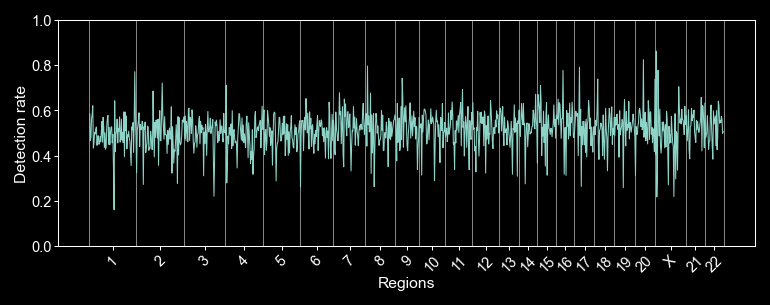

In [65]:
fig, ax = plt.subplots(figsize=(6,2),dpi=150)
_l = ax.plot(1-loss_rates, linewidth=0.5)
ax.set_ylim([0,1])
ax.set_xlabel('Regions', labelpad=1, fontsize=7.5)
ax.set_ylabel('Detection rate', labelpad=1, fontsize=7.5)
# border
[i[1].set_linewidth(0.5) for i in ax.spines.items()]
# ticks
ax.tick_params('both', labelsize=7, 
               width=0.5, length=2,
               pad=1)
ax.vlines(chr_edges-0.5, 0, 1, linewidth=0.25)
ax.set_xticks((chr_edges[1:] + chr_edges[:-1])/2)
ax.set_xticklabels(chr_names, rotation=45)
fig.savefig(os.path.join(figure_folder, f"loss_rates_by_region.png"),
            tranparent=True)
fig.show()

## All ensemble

In [58]:
%%time
from ImageAnalysis3.structure_tools import distance
reload(distance)
all_summary_dict = distance.Chr2ZxysList_2_summaryDict(all_chr_2_zxys_list, si14_codebook, 
                                                       num_threads=32, verbose=True)

-- preparing chr_2_zxys from 12559 cells in 1.926s.
-- summarize 276 inter-chr distances with 12 threads in 257.944s.
Wall time: 4min 20s


In [59]:
# save
save_all_summary_dict = os.path.join(decoder_folder, f"all_summary_dict_n{len(all_chr_2_zxys_list)}.pkl")
print(save_all_summary_dict)
pickle.dump(all_summary_dict, open(save_all_summary_dict, 'wb'))

\\mendel\Mendel_SSD1\Pu_Temp\20220616-hSTG0308_SI14_from_0601\Decoder\all_summary_dict_n12559.pkl


## 5.1 plot

In [60]:
_ordered_chr_names = []
for _chr_name, _chr_reg_id in zip(si14_codebook['chr'], si14_codebook['chr_order']):
    if _chr_name not in _ordered_chr_names:
        _ordered_chr_names.append(_chr_name)
chr_2_indices = {_chr:np.array(si14_codebook.loc[si14_codebook['chr']==_chr].index)
                for _chr in np.unique(si14_codebook['chr'].values)}

_labels_edges = np.array([0] + [np.max(chr_2_indices[_chr]) for _chr in _ordered_chr_names])

C:\Users\puzheng\AppData\Local\Temp/ipykernel_34996/428143250.py:43: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


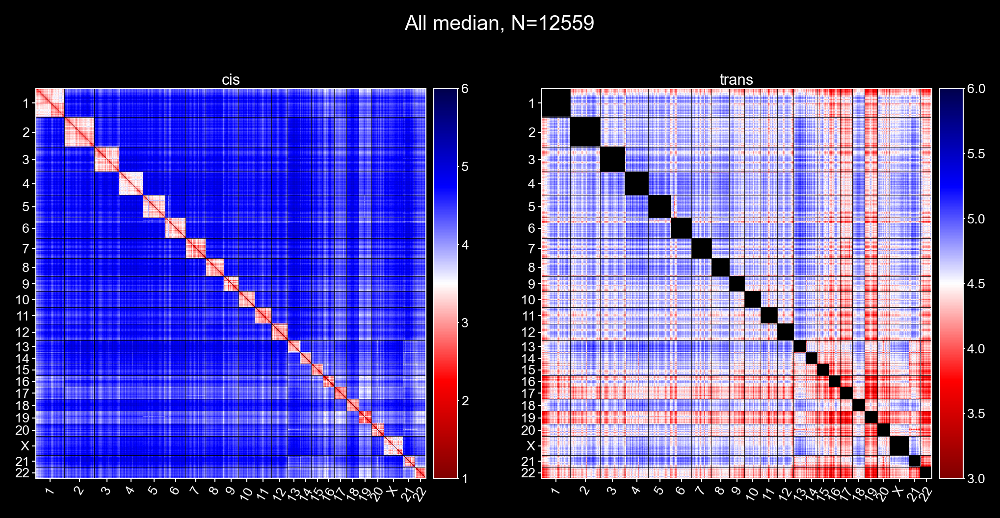

In [63]:
%matplotlib inline

plt.style.use('dark_background')
_single_im_size=3.5
sel_codebook = si14_codebook
sort_by_region = False

_cis_mat, chr_edges, chr_names = distance.assemble_ChrDistDict_2_Matrix(
    all_summary_dict, si14_codebook, 
    sel_codebook=sel_codebook, 
    use_cis=True, sort_by_region=sort_by_region,
)
_trans_mat, chr_edges, chr_names = distance.assemble_ChrDistDict_2_Matrix(
    all_summary_dict, si14_codebook, 
    sel_codebook=sel_codebook, 
    use_cis=False, sort_by_region=sort_by_region,
)

fig, axes = plt.subplots(1, 2, figsize=(_single_im_size*2, _single_im_size*1.1), dpi=300, sharex=True, sharey=True)

ia.figure_tools.distmap.plot_distance_map(_cis_mat/1000, color_limits=[1,6],
                                          ax=axes[0], 
                                            ticks=(chr_edges[1:] + chr_edges[:-1])/2,
                                          tick_labels=chr_names,
                                          font_size=6.5)
ia.figure_tools.distmap.plot_distance_map(_trans_mat/1000, color_limits=[3,6],
                                          ax=axes[1], 
                                          ticks=(chr_edges[1:] + chr_edges[:-1])/2,
                                          tick_labels=chr_names, 
                                          font_size=6.5)

axes[0].set_title(f'cis', fontsize=7.5, pad=2)
axes[1].set_title(f'trans', fontsize=7.5, pad=2)
for _ax in axes:
    _ax.hlines(chr_edges-0.5, 0, len(_cis_mat), color='black', linewidth=0.2)
    _ax.vlines(chr_edges-0.5, 0, len(_cis_mat), color='black', linewidth=0.2)
    _ax.xaxis.set_tick_params(which='both', labelbottom=True)
    _ax.yaxis.set_tick_params(which='both', labelleft=True)

fig.subplots_adjust(wspace=0.2, hspace=0.2, left=0.05, right=0.95, top=0.97, bottom=0.02)
fig.suptitle(f"All median, N={len(all_chr_2_zxys_list)}", fontsize=10, y=0.97)
fig.savefig(os.path.join(figure_folder, f"cis-trans-median_distmap_bychr_all.png"))
fig.show()

In [67]:
nonNeu_classes = ['1','3','5','8','9']
Neu_classes = ['0','2','4','6','7']

In [70]:
majorClass_2_chrZxys = {'nonNeu':[], 'Neu':[]}
for _nn in nonNeu_classes:
    majorClass_2_chrZxys['nonNeu'] += class_2_chr_zxys[_nn]
for _nn in Neu_classes:
    majorClass_2_chrZxys['Neu'] += class_2_chr_zxys[_nn]
        

In [72]:
from ImageAnalysis3.structure_tools import distance
reload(distance)
majorClass_2_summary_dict = {
    _class:distance.Chr2ZxysList_2_summaryDict(_chr_2_zxys_list, si14_codebook, num_threads=32, verbose=True) 
    for _class, _chr_2_zxys_list in majorClass_2_chrZxys.items() 
    if _class not in ['Other'] and len(_chr_2_zxys_list) > min_class_num_cell
}

-- preparing chr_2_zxys from 2077 cells in 0.335s.
-- summarize 276 inter-chr distances with 32 threads in 41.142s.
-- preparing chr_2_zxys from 2712 cells in 0.326s.
-- summarize 276 inter-chr distances with 32 threads in 49.668s.


In [76]:
majorClass_2_summary_dict.keys()

dict_keys(['nonNeu', 'Neu'])

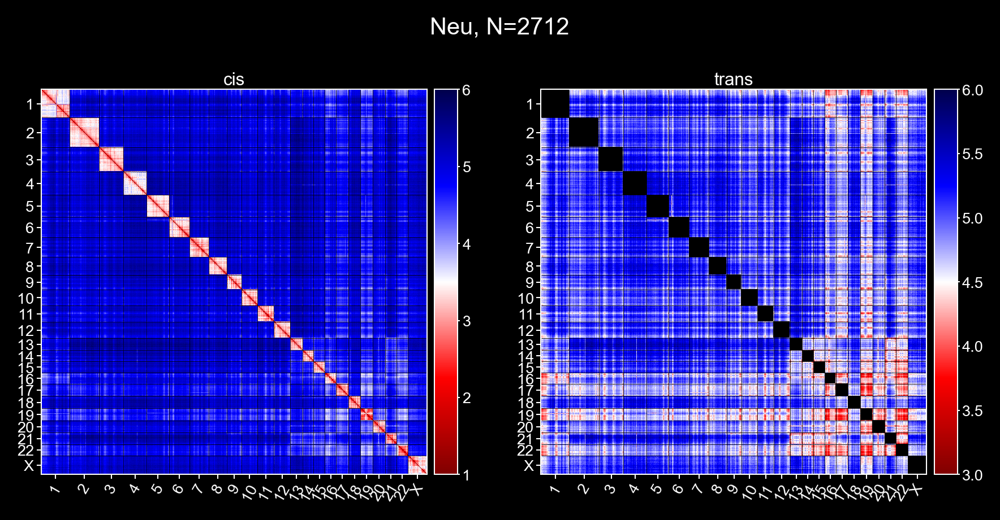

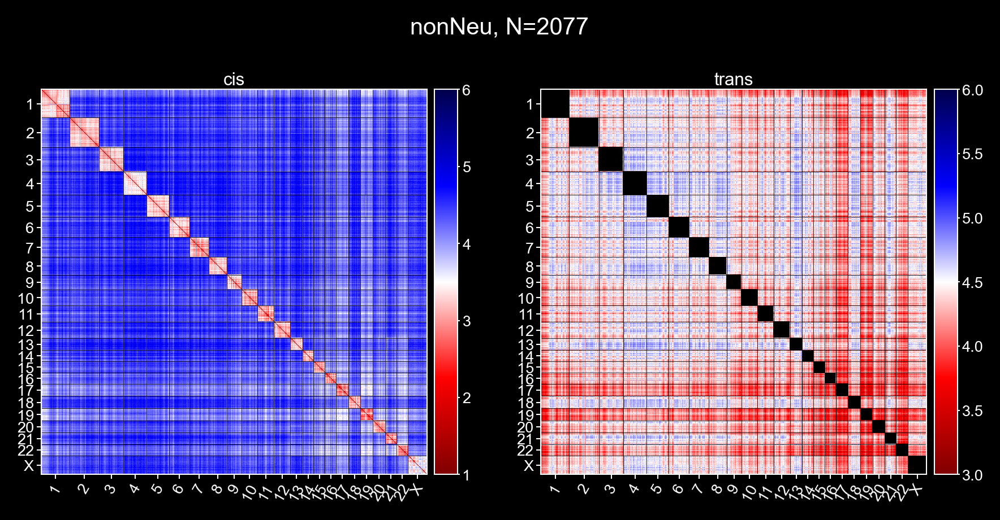

In [77]:
%matplotlib inline

plt.style.use('dark_background')
_single_im_size=3
sel_codebook = si14_codebook
sort_by_region = True

for _class, summary_dict in sorted(majorClass_2_summary_dict.items()):
    
    _cis_mat, chr_edges, chr_names = distance.assemble_ChrDistDict_2_Matrix(
        summary_dict, si14_codebook, 
        sel_codebook=sel_codebook, 
        use_cis=True, sort_by_region=sort_by_region,
    )
    _trans_mat, chr_edges, chr_names = distance.assemble_ChrDistDict_2_Matrix(
        summary_dict, si14_codebook, 
        sel_codebook=sel_codebook, 
        use_cis=False, sort_by_region=sort_by_region,
    )

    fig, axes = plt.subplots(1, 2, figsize=(_single_im_size*2, _single_im_size*1.1), dpi=300, sharex=True, sharey=True)

    ia.figure_tools.distmap.plot_distance_map(_cis_mat/1000, color_limits=[1,6],
                                              ax=axes[0], 
                                                ticks=(chr_edges[1:] + chr_edges[:-1])/2,
                                              tick_labels=chr_names,
                                              font_size=6.5)
    ia.figure_tools.distmap.plot_distance_map(_trans_mat/1000, color_limits=[3,6],
                                              ax=axes[1], 
                                              ticks=(chr_edges[1:] + chr_edges[:-1])/2,
                                              tick_labels=chr_names, 
                                              font_size=6.5)

    axes[0].set_title(f'cis', fontsize=7.5, pad=2)
    axes[1].set_title(f'trans', fontsize=7.5, pad=2)
    for _ax in axes:
        _ax.hlines(chr_edges-0.5, 0, len(_cis_mat), color='black', linewidth=0.2)
        _ax.vlines(chr_edges-0.5, 0, len(_cis_mat), color='black', linewidth=0.2)
        _ax.xaxis.set_tick_params(which='both', labelbottom=True)
        _ax.yaxis.set_tick_params(which='both', labelleft=True)
    
    fig.subplots_adjust(wspace=0.2, hspace=0.2, left=0.05, right=0.95, top=0.97, bottom=0.02)
    fig.suptitle(f"{_class}, N={len(majorClass_2_chrZxys[_class])}", fontsize=10, y=0.97)
    fig.savefig(os.path.join(figure_folder, f"cis-trans-median_distmap_byreg_{_class.replace('/','_')}.png"))
    #fig.show()

C:\Users\puzheng\AppData\Local\Temp/ipykernel_34996/3537790317.py:41: MatplotlibDeprecationWarning: savefig() got unexpected keyword argument "tranparent" which is no longer supported as of 3.3 and will become an error two minor releases later
  fig.savefig(os.path.join(figure_folder, f"all_type_cis_median_distmap_chr-{sel_chr}.png"),
C:\Users\puzheng\AppData\Local\Temp/ipykernel_34996/3537790317.py:46: UserWarning: Matplotlib is currently using module://matplotlib_inline.backend_inline, which is a non-GUI backend, so cannot show the figure.
  fig.show()


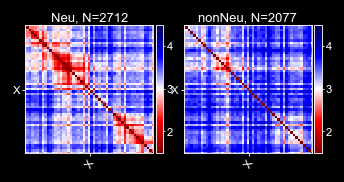

In [83]:
#%matplotlib inline
_single_im_size=1.25
_num_cols = 2
_num_rows =  int(np.ceil(len(majorClass_2_summary_dict)/_num_cols))
fig, axes_list = plt.subplots(_num_rows, _num_cols, 
                              figsize=(_single_im_size*_num_cols, _single_im_size*_num_rows*1.1), 
                              dpi=125,
                              sharex=True, sharey=True)
class_names = sorted(list(majorClass_2_summary_dict.keys()))
_plot_id = 0
#for _row_axes in axes_list:
for _ax in axes_list:
    if _plot_id >= len(class_names):
        continue
    _cis_mat, chr_edges, chr_names = distance.assemble_ChrDistDict_2_Matrix(majorClass_2_summary_dict[class_names[_plot_id]], 
                                                      si14_codebook, use_cis=True, sort_by_region=sort_by_region)
    _ax = ia.figure_tools.distmap.plot_distance_map(
        _cis_mat/1000, color_limits=[1.5, 4.5],
        ticks=(chr_edges[1:] + chr_edges[:-1])/2,
        tick_labels=chr_names,
        font_size=6.5,
        ax=_ax,)
    _ax.set_title(f"{class_names[_plot_id]}, N={len(majorClass_2_chrZxys[class_names[_plot_id]])}", 
                  fontsize=7.5, pad=2)
    _ax.hlines(chr_edges, 0, len(_cis_mat), color='black', linewidth=0.25)
    _ax.vlines(chr_edges, 0, len(_cis_mat), color='black', linewidth=0.25)
    _ax.xaxis.set_tick_params(which='both', labelbottom=True)
    _ax.yaxis.set_tick_params(which='both', labelleft=True)
    # next plot
    _plot_id += 1
        
fig.subplots_adjust(wspace=0.15, hspace=0.15, left=0.02, right=0.97, top=0.97, bottom=0.02)


if visualize_chr:
    #sel_chr = '19'
    for sel_chr in chr_2_indices:
        sel_chr_inds = chr_2_indices[sel_chr]
        _ax.set_xlim([min(sel_chr_inds), max(sel_chr_inds)])
        _ax.set_ylim([ max(sel_chr_inds), min(sel_chr_inds)])
        fig.savefig(os.path.join(figure_folder, f"all_type_cis_median_distmap_chr-{sel_chr}.png"),
                    tranparent=True)
else:
    fig.savefig(os.path.join(figure_folder, f"major_type_cis_median_distmap.png"),
                tranparent=True)
fig.show()

In [99]:
reload(distance)

<module 'ImageAnalysis3.structure_tools.distance' from 'E:\\Users\\puzheng\\Documents\\ImageAnalysis3\\structure_tools\\distance.py'>

<IPython.core.display.Javascript object>


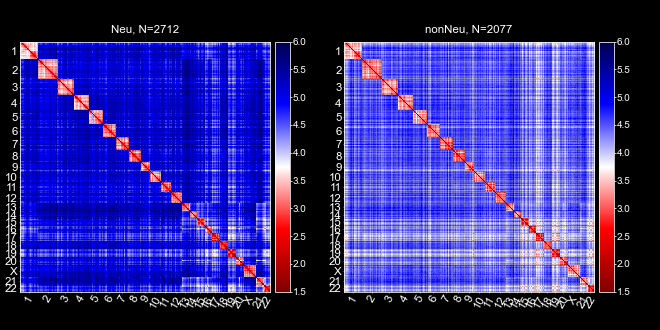

In [101]:
%matplotlib notebook
from mpl_toolkits.axes_grid1 import make_axes_locatable
plt.style.use('dark_background')

keys = ['Neu','nonNeu']

num_x = 1
num_y = len(keys)
im_size = 3
_font_size = 7.5
_ticklabel_width = 0.5
_ticklabel_size = 0.5
fig, axes = plt.subplots(num_x,num_y, figsize=(im_size*num_y,im_size*num_x), 
                         sharex=True, sharey=True, dpi=100)

for _i, _ax in enumerate(axes):
    _key = keys[_i]
    _mat, _chr_edges, _chr_names = distance.assemble_ChrDistDict_2_Matrix(
        majorClass_2_summary_dict[_key], si14_codebook, use_cis=True, use_trans=False, sort_by_region=False)
    _mat = _mat / 1000
    
    ia.figure_tools.distmap.plot_distance_map(_mat, color_limits=[1.5,6],
                                              ax=_ax, 
                                              ticks=(_chr_edges[1:] + _chr_edges[:-1])/2,
                                              tick_labels=_chr_names,
                                              font_size=_font_size-1)
    # Lines between chr
    _ax.hlines(_chr_edges-0.5, 0, len(_mat), color='black', linewidth=0.2)
    _ax.vlines(_chr_edges-0.5, 0, len(_mat), color='black', linewidth=0.2)
    _ax.xaxis.set_tick_params(which='both', labelbottom=True)
    _ax.yaxis.set_tick_params(which='both', labelleft=True)
    _ax.tick_params('both', labelsize=_font_size, 
                    width=_ticklabel_width, length=_ticklabel_size,
                    pad=1, ) # remove bottom ticklabels for ax1
    # title
    _ax.set_title(f"{_key}, N={len(majorClass_2_chrZxys[_key])}", fontsize=_font_size)
    
fig.subplots_adjust(wspace=0.2, hspace=0.2, left=0.03, right=0.93, top=0.97, bottom=0.02)
fig.savefig(os.path.join(figure_folder, f'median_trans_majortypes_dark.png'), transparent=True, dpi=300)

plt.show()